In [1]:
%matplotlib inline

%load_ext autoreload
%autoreload 2

In [32]:
import os

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from PIL import Image
import seaborn as sns
sns.set_context('notebook')
import numpy as np
import pandas as pd
from astropy.table import Table  # just to read fits

In [3]:
os.chdir('/home/walml/repos/zoobot')

In [4]:
ml_loc = 'results/temp/decals_n2_allq_m0_all_mean.csv'  # load the predictions (only one model here)
ml = pd.read_csv(ml_loc)














print('Galaxies with ML predictions: ' + str(len(ml)))
ml['bar_any_fraction'] = ml['bar_strong_fraction'] + ml['bar_weak_fraction']

Galaxies with ML predictions: 309398


In [25]:
ml.columns.values

array(['iauname', 'smooth-or-featured_smooth_fraction',
       'smooth-or-featured_featured-or-disk_fraction',
       'smooth-or-featured_artifact_fraction',
       'disk-edge-on_yes_fraction', 'disk-edge-on_no_fraction',
       'has-spiral-arms_yes_fraction', 'has-spiral-arms_no_fraction',
       'bar_strong_fraction', 'bar_weak_fraction', 'bar_no_fraction',
       'bulge-size_dominant_fraction', 'bulge-size_large_fraction',
       'bulge-size_moderate_fraction', 'bulge-size_small_fraction',
       'bulge-size_none_fraction', 'how-rounded_round_fraction',
       'how-rounded_in-between_fraction',
       'how-rounded_cigar-shaped_fraction', 'edge-on-bulge_boxy_fraction',
       'edge-on-bulge_none_fraction', 'edge-on-bulge_rounded_fraction',
       'spiral-winding_tight_fraction', 'spiral-winding_medium_fraction',
       'spiral-winding_loose_fraction', 'spiral-arm-count_1_fraction',
       'spiral-arm-count_2_fraction', 'spiral-arm-count_3_fraction',
       'spiral-arm-count_4_fractio

In [24]:
catalog_loc = 'data/decals/decals_master_catalog.csv'
catalog = pd.read_csv(catalog_loc, dtype={'subject_id': str})  # original catalog
# catalog['file_loc'] = catalog['local_png_loc'].apply(lambda x: '/media/walml/beta/galaxy_zoo/gz2' + x[32:])
# catalog['id_str'] = catalog['dr7objid'].apply(lambda x: 'dr7objid_' + str(x))
ml = pd.merge(ml, catalog[['file_loc', 'iauname']], on='iauname', how='inner')  # add file loc

In [5]:
# also add in the NSA catalog values, for redshift

In [6]:
nsa = Table.read('/media/walml/beta/galaxy_zoo/decals/catalogs/nsa_v1_0_0_decals_dr5.fits')

In [7]:
# usually I just pull out the useful columns and merge straight away, but this can cause endian problems
nsa_iaunames = list(nsa['iauname'])
nsa_redshifts = list(nsa['z'])
# nsa_df = nsa[['iauname', 'z']].to_pandas()


In [8]:
nsa_df = pd.DataFrame(data={'iauname': nsa_iaunames, 'redshift': nsa_redshifts})


In [9]:
ml = pd.merge(ml, nsa_df, on='iauname', how='inner')
len(ml)

309398

(0.3816637470184035,
 0.5552750825797194,
 0.6152334533513468,
 0.7071765169781318)

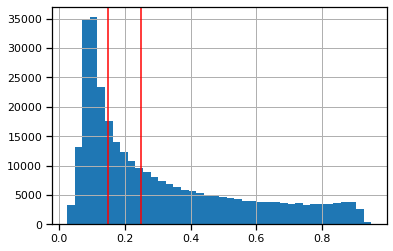

In [37]:
ml['smooth-or-featured_featured-or-disk_fraction'].hist(bins=40)
plt.axvline(0.15, color='r')
plt.axvline(0.25, color='r')
(ml['smooth-or-featured_featured-or-disk_fraction'] < 0.15).mean(), (ml['smooth-or-featured_featured-or-disk_fraction'] < 0.25).mean(), (ml['smooth-or-featured_featured-or-disk_fraction'] < 0.3).mean(), (ml['smooth-or-featured_featured-or-disk_fraction'] < 0.4).mean()

In [28]:
# copied from touch table
def quality_check(df, bin_col, n_bins=10, n_galaxies_per_bin=10):
    df['binned'], bins = pd.cut(df[bin_col], n_bins, labels=False, retbins=True)
    scale = 3
    plt.figure(figsize=(scale * n_galaxies_per_bin, scale * n_bins))
    gs1 = gridspec.GridSpec(n_galaxies_per_bin, n_bins)
    gs1.update(wspace=0.0, hspace=0.0)
    for bin_n in range(n_bins):
        selected_df = df.query('binned == {}'.format(bin_n))
        selected_df = selected_df.sample(len(selected_df))  # shuffle
        for galaxy_n in range(n_galaxies_per_bin):
            if galaxy_n < len(selected_df):
                galaxy = selected_df.iloc[galaxy_n]
                image = Image.open(galaxy['file_loc'])
                ax = plt.subplot(gs1[galaxy_n, bin_n])
                ax.imshow(image)
                ax.text(50, 50, '{:.2f}'.format(galaxy[bin_col]), fontsize=12, color='r')
#                 ax.text(50, 120, 'N = {}'.format(galaxy['total']), fontsize=16, color='r')
                if galaxy_n == 0:
                    ax.text(80, -50, 'Feat: {:.2f} to {:.2f}'.format(bins[bin_n], bins[bin_n + 1]), fontsize=16, color='black')
                ax.axis('off')
#     plt.savefig('touch_table_retirement_{}.pdf'.format(retirement_limit))
    return df

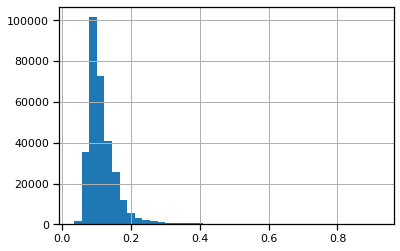

In [44]:
ml['smooth-or-featured_artifact_fraction'].hist(bins=40)

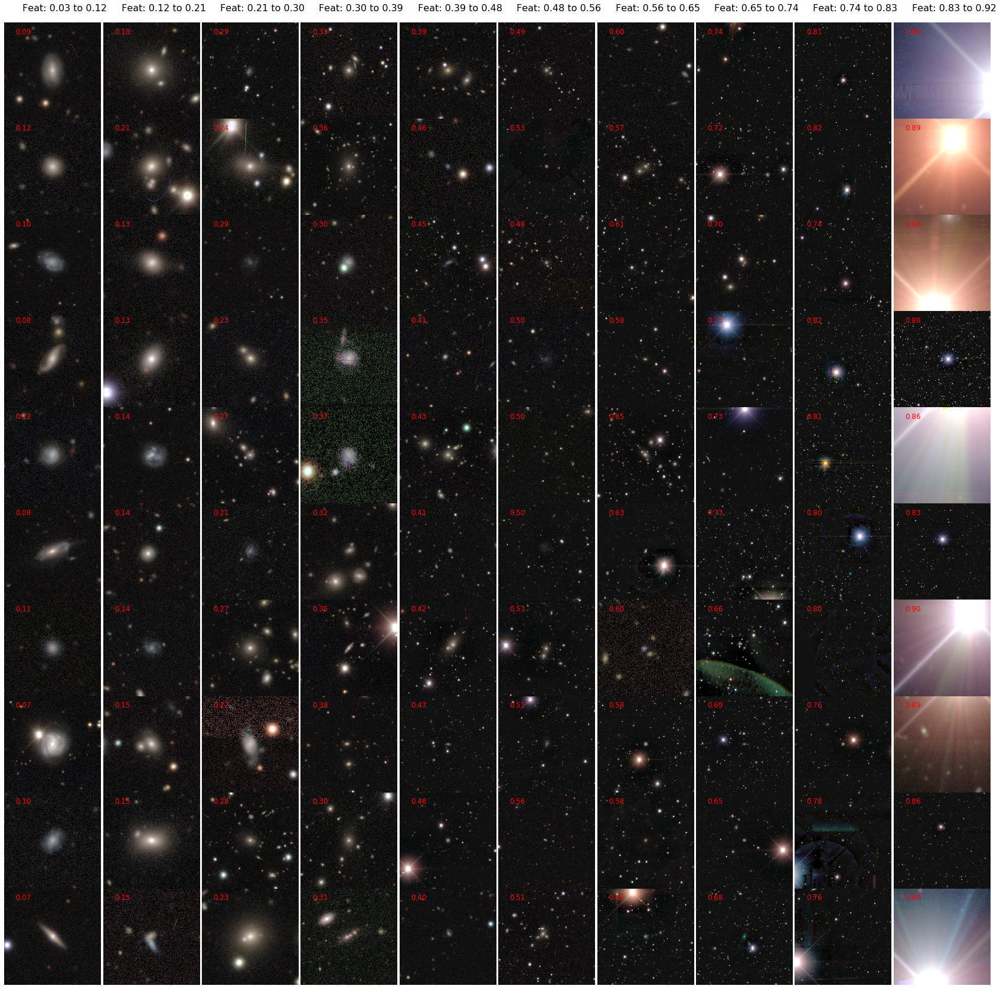

In [46]:

narrow_band = ml['smooth-or-featured_artifact_fraction'] < 0.3

_ = quality_check(ml, 'smooth-or-featured_artifact_fraction')

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


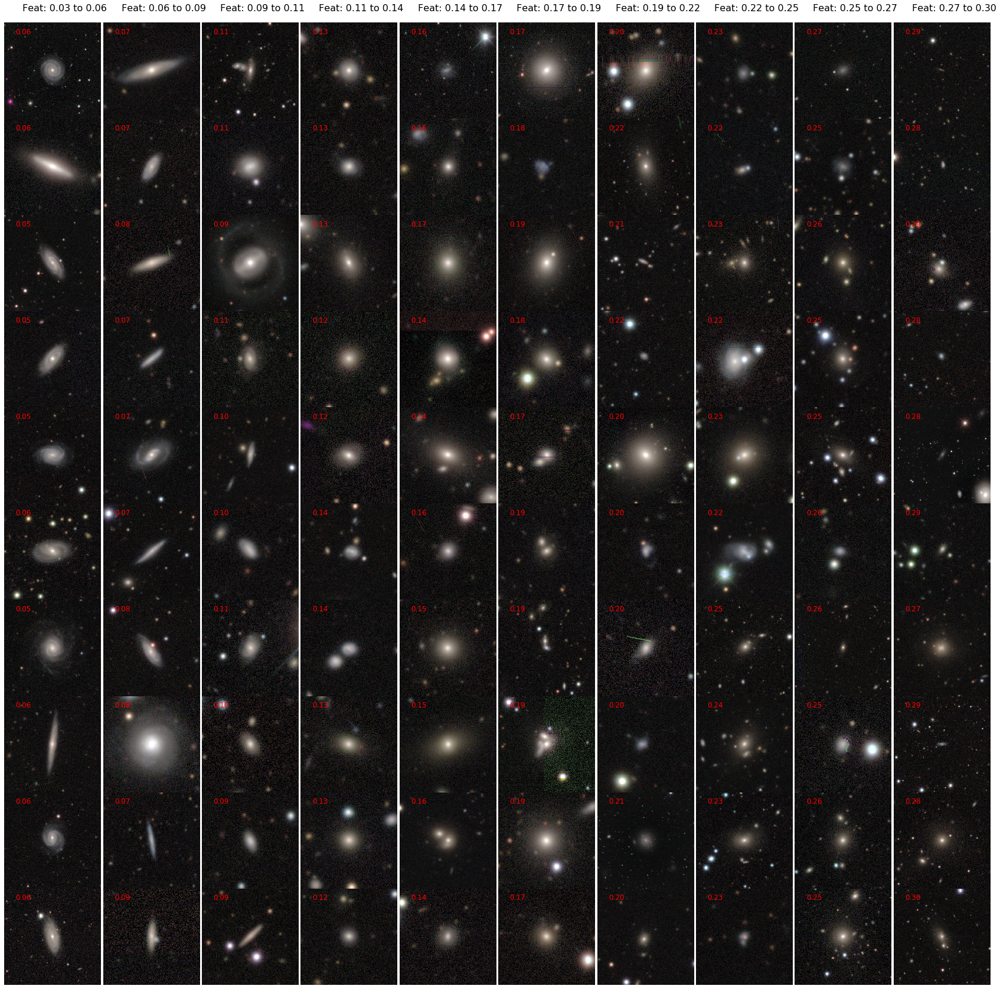

In [45]:

narrow_band = ml['smooth-or-featured_artifact_fraction'] < 0.3

_ = quality_check(ml[narrow_band], 'smooth-or-featured_artifact_fraction')

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


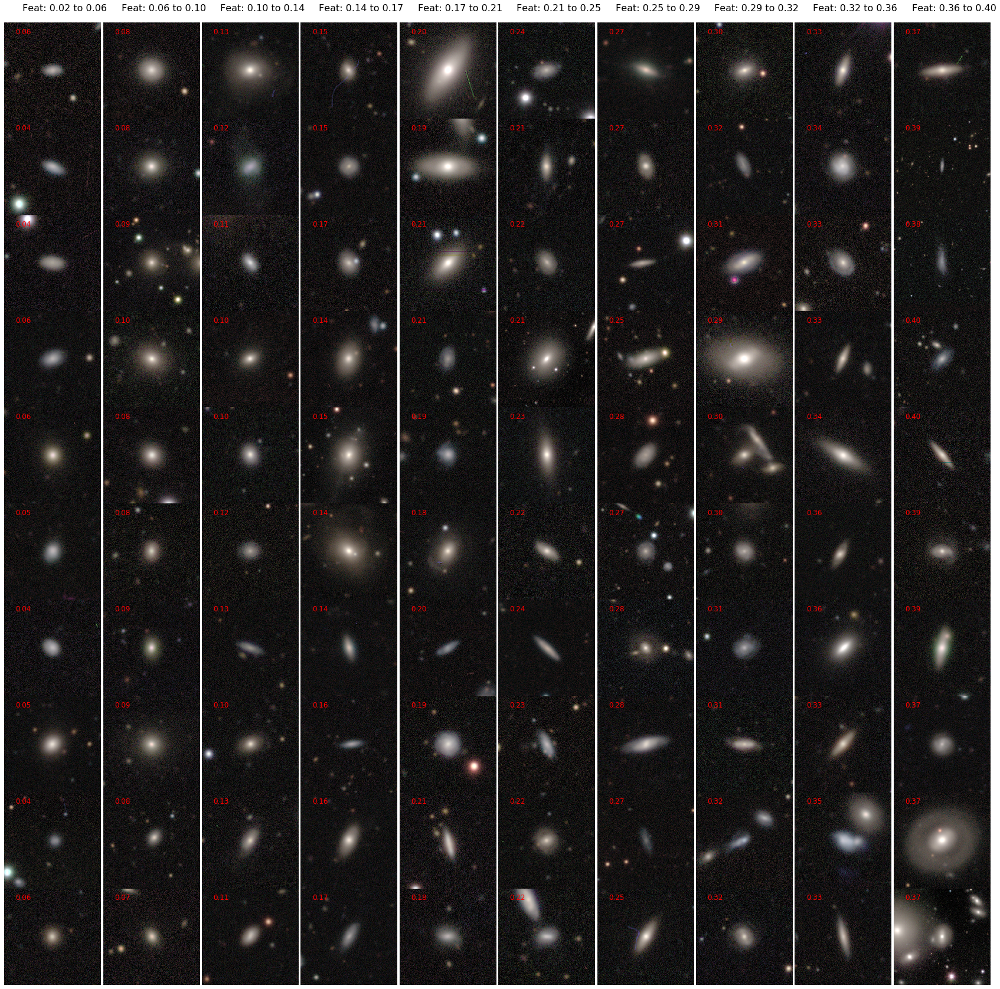

In [48]:

narrow_band = ml['smooth-or-featured_featured-or-disk_fraction'] < 0.4
not_artifact = ml['smooth-or-featured_artifact_fraction'] < 0.2

_ = quality_check(ml[not_artifact & narrow_band], 'smooth-or-featured_featured-or-disk_fraction')

In [ ]:
ml['smooth-or-featured_featured-or-disk_fraction'] > 0.